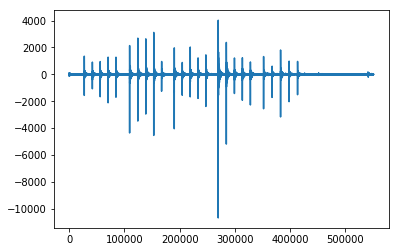

<class 'numpy.ndarray'>


In [418]:
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav
from scipy.fftpack import fft
import numpy as np
import mpld3

rate, dataSound = wav.read('output.wav')
#dataSound = np.array(dataSound)
dataSound = dataSound/100000
fft_out = fft(dataSound)
%matplotlib inline
mpld3.enable_notebook()
plt.plot(dataSound)
#plt.plot(np.abs(fft_out))
plt.show()
print((type(dataSound)))

In [419]:
print(rate)
    

44100


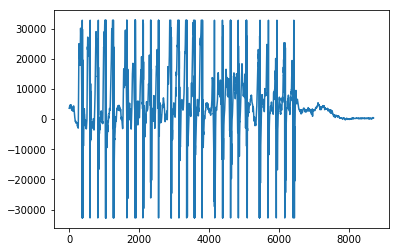

In [420]:
import csv
data = []
with open('sensorInfo.csv', 'r') as readFile:
    newFileReader = csv.reader(readFile)
    for row in readFile:
        currentLine = []
        for x in row.split(','):
            try:
                currentLine.append(float(x))
            except Exception:
                pass
        data.append(currentLine)
        
data = np.array(data)

plt.plot(data[0:, 0])
plt.show()

        



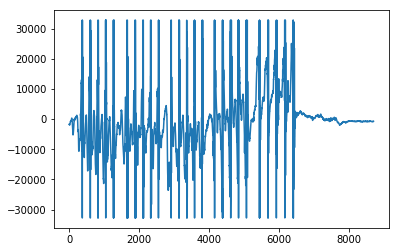

In [421]:
plt.plot(data[0:, 1])


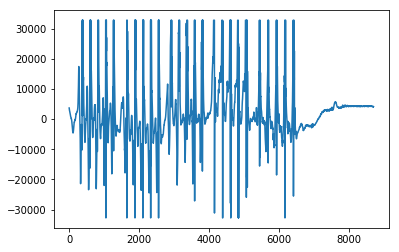

In [422]:
plt.plot(data[0:, 2])


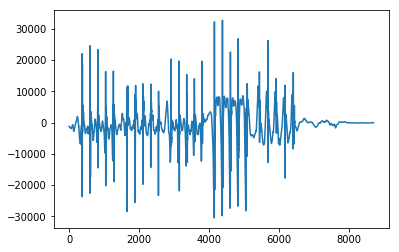

In [423]:
plt.plot(data[0:, 3])


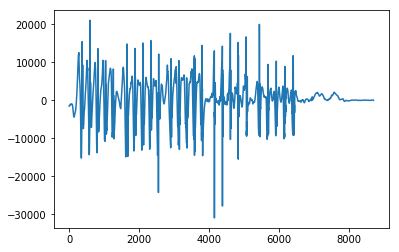

In [424]:
plt.plot(data[0:, 4])


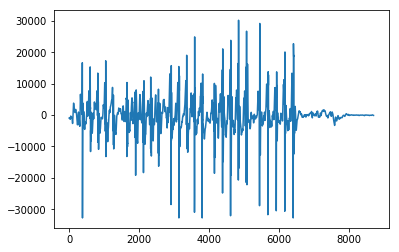

In [425]:
plt.plot(data[0:, 5])


In [426]:
print(len(data[0:, :2]))


8710


[[ 3589. -1695.  3681.]
 [ 3606. -1675.  3661.]
 [ 3604. -1729.  3510.]
 ...
 [  375.  -721.  4185.]
 [  354.  -732.  4170.]
 [  365.  -730.  4159.]]


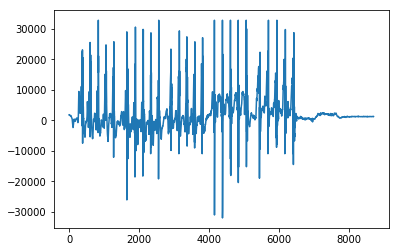

In [427]:
print(data[0:,:3])
accelMean = (np.mean(data[0:, :3], axis=1))

plt.plot(accelMean)

In [428]:
# 20 antes y 40 despues

included = 0
punch = []
for x in range(len(accelMean)):
    if (accelMean[x]) >= 16500 and x > included:
        currentPunch = []
        xvalue = x - 50
        for i in range(100):
            currentPunch.append(data[xvalue + i])
        punch.append(currentPunch)
        included = x+50
#print(punch)
punch = np.array(punch)

#plt.plot(punch[0, :60, 2])

        
        


In [437]:
soundIncluded = 0
punchSound = []
for x in range (len(dataSound)):
    if abs(dataSound[x]) >= 1100 and x > soundIncluded:
        currentPunch = []
        xvalue = x - 100
        for i in range(400):
            try:
                currentPunch.append(dataSound[x+i])
            except Exception:
                pass
        punchSound.append(currentPunch)
        soundIncluded = x + 300
labels = np.array([[0],[0],[0],[0],[0],[1],[1],[1],[1],[1],[2],[2],[2],[2],[2],[3],[3],[3],[3],[3],[4],[4],[4],[4],[4]])

# with open('sensors1.csv', 'a') as appendFile:
#     newFileWritter = csv.writer(appendFile)
#     newFileWritter.writerows(punch)
# with open('labels1.csv', 'a') as appendFile:
#     newFileWritter = csv.writer(appendFile)
#     newFileWritter.writerows(labels)
# with open('sounds1.csv', 'a') as appendFile:
#     newFileWritter = csv.writer(appendFile)
#     newFileWritter.writerows(punchSound)
print(len(punch))
print(len(punchSound))

#[acX, acY, acZ, gyX, gyY, gyZ, time]*60 
#[sound]*2500
#[label]

25
25


909.65259


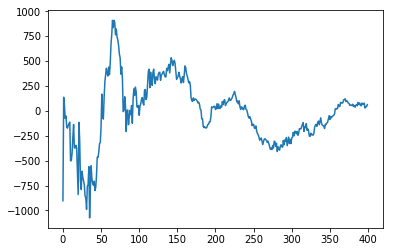

In [430]:
i = 1
plt.plot(punchSound[i])
punchSound = np.array(punchSound)
print(max(punchSound[i, :500]))

In [431]:
import peakutils

j = 0
#plt.plot(punch[j, :60, 0])
print(np.mean(punch[j,:60, 0]))
print(np.std(punch[j,:60, 0]))


16451.666666666668
15452.364280444452


In [432]:

j=14
cb = np.array(punch[j,:60, 1])
indices = peakutils.indexes(cb, thres=0.45, min_dist=0.1)

print(np.mean(indices))

55.0


In [433]:
from scipy.stats import kurtosis
j = 3
kurtosis(punch[j,:60, 1])

0.9581047929236646